In [ ]:
import zipfile
import os

# Define the path to the zip file
zip_file_path = '/content/heart_dataset_sup.zip'
extract_path = '/content/heart_dataset_sup'

# Extract the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

# Function to list the folder structure and count the contents of each folder
def list_folders_and_contents(base_path):
    folder_structure = {}
    for root, dirs, files in os.walk(base_path):
        folder_structure[root] = len(files)
    return folder_structure

# Get the folder structure of the extracted data
folder_structure = list_folders_and_contents(extract_path)

# Print the folder structure
for folder, file_count in folder_structure.items():
    print(f"Folder: {folder}, Number of files: {file_count}")

Folder: /content/heart_dataset_sup, Number of files: 0
Folder: /content/heart_dataset_sup/heart_dataset, Number of files: 0
Folder: /content/heart_dataset_sup/heart_dataset/images, Number of files: 0
Folder: /content/heart_dataset_sup/heart_dataset/images/val, Number of files: 120
Folder: /content/heart_dataset_sup/heart_dataset/images/train, Number of files: 279
Folder: /content/heart_dataset_sup/heart_dataset/labels, Number of files: 0
Folder: /content/heart_dataset_sup/heart_dataset/labels/val_cleaned, Number of files: 120
Folder: /content/heart_dataset_sup/heart_dataset/labels/val, Number of files: 120
Folder: /content/heart_dataset_sup/heart_dataset/labels/train, Number of files: 279
Folder: /content/heart_dataset_sup/heart_dataset/labels/train_cleaned, Number of files: 279


In [ ]:
import os
import json

# Define the path to labels directory
labels_train_path = '/content/heart_dataset_sup/heart_dataset/labels/train'
labels_val_path = '/content/heart_dataset_sup/heart_dataset/labels/val'

# Function to extract classes from labels
def extract_classes(labels_path):
    classes = set()
    for label_file in os.listdir(labels_path):
        label_path = os.path.join(labels_path, label_file)
        with open(label_path, 'r') as file:
            data = file.readlines()
            for line in data:
                class_id = line.split()[0]  # Assuming class ID is the first column
                classes.add(class_id)
    return classes

# Check for classes in train and val sets
classes_train = extract_classes(labels_train_path)
classes_val = extract_classes(labels_val_path)

if not classes_train:
    print("No classes found in training data. Defining default class: 'Heart'.")
    classes_train = {"Heart"}
if not classes_val:
    print("No classes found in validation data. Defining default class: 'Heart'.")
    classes_val = {"Heart"}

# Display the detected or created classes
print(f"Classes in training set: {classes_train}")
print(f"Classes in validation set: {classes_val}")

Classes in training set: {'2', '1', '0'}
Classes in validation set: {'2', '1', '0'}


In [ ]:
# Define class ID to name mapping
class_id_to_name = {
    '0': 'Healthy Heart',
    '1': 'Mild Abnormality',
    '2': 'Severe Abnormality'
}

# Display the mapped classes
print("Class names mapped to IDs:")
for class_id, class_name in class_id_to_name.items():
    print(f"Class ID: {class_id}, Class Name: {class_name}")

Class names mapped to IDs:
Class ID: 0, Class Name: Healthy Heart
Class ID: 1, Class Name: Mild Abnormality
Class ID: 2, Class Name: Severe Abnormality


In [ ]:
import torch.nn as nn
from torchvision import models
import torch

# Check if CUDA is available and set the device accordingly
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Extend ResNet18 model
class ResNetForBoundingBoxAndClass(nn.Module):
    def __init__(self, num_classes):
        super(ResNetForBoundingBoxAndClass, self).__init__()
        self.resnet = models.resnet18(pretrained=True)
        in_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Identity()  # Remove original FC layer
        self.fc_bbox = nn.Linear(in_features, 4)  # For bounding box regression
        self.fc_class = nn.Linear(in_features, num_classes)  # For class classification

    def forward(self, x):
        features = self.resnet(x)
        bbox = self.fc_bbox(features)
        class_logits = self.fc_class(features)
        return bbox, class_logits

# Initialize the model
num_classes = len(class_id_to_name)  # 3 classes: Healthy Heart, Mild Abnormality, Severe Abnormality
model = ResNetForBoundingBoxAndClass(num_classes)
model = model.to(device)

In [ ]:
pip install torch torchvision


In [ ]:
# Define loss functions
bbox_loss_fn = nn.MSELoss()  # For bounding box regression
class_loss_fn = nn.CrossEntropyLoss()  # For class prediction

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [ ]:
import torch
from torch.utils.data import Dataset
from PIL import Image
import os

# Dataset class for loading images and labels
class HeartDataset(Dataset):
    def __init__(self, images_path, labels_path, transform=None):
        self.images_path = images_path
        self.labels_path = labels_path
        self.image_files = sorted(os.listdir(images_path))
        self.label_files = sorted(os.listdir(labels_path))
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.images_path, self.image_files[idx])
        label_path = os.path.join(self.labels_path, self.label_files[idx])

        # Load image
        image = Image.open(img_path).convert("RGB")

        # Load labels
        with open(label_path, 'r') as file:
            data = file.readlines()
        boxes = []
        labels = []
        for line in data:
            parts = line.split()
            labels.append(int(parts[0]))  # Convert class ID to integer
            boxes.append([float(x) for x in parts[1:]])  # Convert bounding box coordinates to floats
        boxes = torch.tensor(boxes)
        labels = torch.tensor(labels)

        if self.transform:
            image = self.transform(image)

        return image, {"boxes": boxes, "labels": labels}

In [ ]:
from torch.utils.data import DataLoader
from torchvision import transforms

# Paths to training and validation image and label directories
train_images_path = '/content/heart_dataset_sup/heart_dataset/images/train'
train_labels_path = '/content/heart_dataset_sup/heart_dataset/labels/train'
val_images_path = '/content/heart_dataset_sup/heart_dataset/images/val'
val_labels_path = '/content/heart_dataset_sup/heart_dataset/labels/val'



# Define image transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to 224x224
    transforms.ToTensor(),  # Convert images to PyTorch tensors
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize for pre-trained models
])

# Create train and validation datasets
train_dataset = HeartDataset(
    images_path=train_images_path,
    labels_path=train_labels_path,
    transform=transform
)

val_dataset = HeartDataset(
    images_path=val_images_path,
    labels_path=val_labels_path,
    transform=transform
)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)

print(f"Number of training samples: {len(train_dataset)}")
print(f"Number of validation samples: {len(val_dataset)}")

Number of training samples: 279
Number of validation samples: 120


In [ ]:
# Transform to resize and normalize the input images
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to 224x224
    transforms.ToTensor(),  # Convert to PyTorch tensors
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

In [ ]:
# Modify ResNet for multi-task learning (bounding box + classification)
class ResNetForBoundingBoxAndClass(nn.Module):
    def __init__(self, num_classes):
        super(ResNetForBoundingBoxAndClass, self).__init__()
        self.resnet = models.resnet18(pretrained=True)
        in_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Identity()  # Remove the original FC layer
        self.fc_bbox = nn.Linear(in_features, 4)  # For bounding box prediction
        self.fc_class = nn.Linear(in_features, num_classes)  # For class prediction

    def forward(self, x):
        features = self.resnet(x)
        bbox = self.fc_bbox(features)
        class_logits = self.fc_class(features)
        return bbox, class_logits

In [ ]:
# Validate label files
import os

def validate_labels(labels_path):
    for label_file in os.listdir(labels_path):
        file_path = os.path.join(labels_path, label_file)
        with open(file_path, 'r') as file:
            for line in file:
                parts = line.split()
                if len(parts) != 5:  # <class_id>, <x_min>, <y_min>, <x_max>, <y_max>
                    print(f"Invalid line in {label_file}: {line.strip()}")

# Check training and validation labels
print("Validating training labels...")
validate_labels(train_labels_path)

print("Validating validation labels...")
validate_labels(val_labels_path)

Validating training labels...
Invalid line in original_2D_01_1938_jpg.rf.92754db231d5182428457712cc035921.txt: 1 0.41338028125 0.7414516124999999 0.447746478125 0.7849999999999999 0.4857746484375 0.82 0.5391549296875 0.8504838703125 0.6039436625 0.854838709375 0.6497183093750001 0.854838709375 0.691690140625 0.8417741937500001 0.691690140625 0.8374193546875001 0.7069014078125 0.8330645156250001 0.75267605625 0.8156451609375001 0.7869014078125 0.793709678125 0.8326760562500001 0.7545161296875 0.8478873234375 0.7108064515625 0.8554929578125 0.64967741875 0.8707042250000001 0.6061290328125 0.8746478874999999 0.5667741937499999 0.8746478874999999 0.518709678125 0.8630985921875001 0.4620967734375 0.8554929578125 0.40967741875 0.8326760562500001 0.3790322578125 0.813661971875 0.3441935484375 0.7830985921875 0.31354838749999997 0.75267605625 0.283064515625 0.7183098593749999 0.2656451609375 0.66873239375 0.25693548437499997 0.630704225 0.24370967812500002 0.5925352109375 0.2393548390625 0.539

In [ ]:
import os

def clean_labels(labels_path):
    cleaned_dir = f"{labels_path}_cleaned"
    os.makedirs(cleaned_dir, exist_ok=True)

    for label_file in os.listdir(labels_path):
        input_path = os.path.join(labels_path, label_file)
        output_path = os.path.join(cleaned_dir, label_file)

        with open(input_path, 'r') as infile, open(output_path, 'w') as outfile:
            for line in infile:
                parts = line.split()
                if len(parts) == 5:  # Valid line with <class_id> <x_min> <y_min> <x_max> <y_max>
                    outfile.write(line)
                else:
                    print(f"Skipping invalid line in {label_file}: {line.strip()}")

    print(f"Cleaned labels saved to {cleaned_dir}")
    return cleaned_dir

# Clean the training and validation labels
train_labels_path_cleaned = clean_labels(train_labels_path)
val_labels_path_cleaned = clean_labels(val_labels_path)

Skipping invalid line in original_2D_01_1938_jpg.rf.92754db231d5182428457712cc035921.txt: 1 0.41338028125 0.7414516124999999 0.447746478125 0.7849999999999999 0.4857746484375 0.82 0.5391549296875 0.8504838703125 0.6039436625 0.854838709375 0.6497183093750001 0.854838709375 0.691690140625 0.8417741937500001 0.691690140625 0.8374193546875001 0.7069014078125 0.8330645156250001 0.75267605625 0.8156451609375001 0.7869014078125 0.793709678125 0.8326760562500001 0.7545161296875 0.8478873234375 0.7108064515625 0.8554929578125 0.64967741875 0.8707042250000001 0.6061290328125 0.8746478874999999 0.5667741937499999 0.8746478874999999 0.518709678125 0.8630985921875001 0.4620967734375 0.8554929578125 0.40967741875 0.8326760562500001 0.3790322578125 0.813661971875 0.3441935484375 0.7830985921875 0.31354838749999997 0.75267605625 0.283064515625 0.7183098593749999 0.2656451609375 0.66873239375 0.25693548437499997 0.630704225 0.24370967812500002 0.5925352109375 0.2393548390625 0.5391549296875 0.23935483

In [ ]:
import os

def clean_labels(labels_path):
    cleaned_dir = f"{labels_path}_cleaned"
    os.makedirs(cleaned_dir, exist_ok=True)

    for label_file in os.listdir(labels_path):
        input_path = os.path.join(labels_path, label_file)
        output_path = os.path.join(cleaned_dir, label_file)

        with open(input_path, 'r') as infile, open(output_path, 'w') as outfile:
            for line in infile:
                parts = line.strip().split()
                if len(parts) >= 5:  # Check if line has at least <class_id> <x_min> <y_min> <x_max> <y_max>
                    class_id = parts[0]
                    bbox = parts[1:5]  # Extract the first 4 coordinates
                    try:
                        # Ensure all parts are valid floats
                        bbox = [float(x) for x in bbox]
                        outfile.write(f"{class_id} {' '.join(map(str, bbox))}\n")
                    except ValueError:
                        print(f"Skipping invalid line (non-numeric values) in {label_file}: {line.strip()}")
                else:
                    print(f"Skipping invalid line (too few values) in {label_file}: {line.strip()}")

    print(f"Cleaned labels saved to {cleaned_dir}")
    return cleaned_dir

# Paths to the label directories
train_labels_path = '/content/heart_dataset_sup/heart_dataset/labels/train'
val_labels_path = '/content/heart_dataset_sup/heart_dataset/labels/val'

# Clean both training and validation label files
train_labels_path_cleaned = clean_labels(train_labels_path)
val_labels_path_cleaned = clean_labels(val_labels_path)

Cleaned labels saved to /content/heart_dataset_sup/heart_dataset/labels/train_cleaned
Cleaned labels saved to /content/heart_dataset_sup/heart_dataset/labels/val_cleaned


In [ ]:
train_labels_path_cleaned = '/content/heart_dataset_sup/heart_dataset/labels/train_cleaned'
val_labels_path_cleaned = '/content/heart_dataset_sup/heart_dataset/labels/val_cleaned'

train_dataset = HeartDataset(
    images_path=train_images_path,
    labels_path=train_labels_path_cleaned,
    transform=transform
)

val_dataset = HeartDataset(
    images_path=val_images_path,
    labels_path=val_labels_path_cleaned,
    transform=transform
)

In [ ]:
class HeartDataset(Dataset):
    def __init__(self, images_path, labels_path, transform=None):
        self.images_path = images_path
        self.labels_path = labels_path
        self.image_files = sorted(os.listdir(images_path))
        self.label_files = sorted(os.listdir(labels_path))
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.images_path, self.image_files[idx])
        label_path = os.path.join(self.labels_path, self.label_files[idx])

        # Load image
        image = Image.open(img_path).convert("RGB")

        boxes = []
        labels = []

        with open(label_path, 'r') as file:
            for line in file:
                parts = line.strip().split()
                if len(parts) == 5:  # Valid format: class_id + 4 bbox coordinates
                    try:
                        class_id = int(parts[0])
                        bbox = [float(x) for x in parts[1:]]
                        if len(bbox) == 4 and all(0 <= coord <= 1 for coord in bbox):
                            labels.append(class_id)
                            boxes.append(bbox)
                        else:
                            print(f"Skipping invalid bbox in {label_path}: {line.strip()}")
                    except ValueError as e:
                        print(f"Error parsing line in {label_path}: {line.strip()} - {e}")
                else:
                    print(f"Invalid format in {label_path}: {line.strip()}")

        if len(boxes) == 0:
            print(f"No valid bounding boxes in {label_path}. Returning empty tensors.")
            boxes = torch.empty((0, 4), dtype=torch.float32)
            labels = torch.empty((0,), dtype=torch.int64)
        else:
            try:
                boxes = torch.tensor(boxes, dtype=torch.float32)
                labels = torch.tensor(labels, dtype=torch.int64)
            except ValueError as e:
                print(f"Error creating tensors for {label_path}: {e}")
                boxes = torch.empty((0, 4), dtype=torch.float32)
                labels = torch.empty((0,), dtype=torch.int64)

        if self.transform:
            image = self.transform(image)

        return image, {"boxes": boxes, "labels": labels}

In [ ]:
train_dataset = HeartDataset(
    images_path='/content/heart_dataset_sup/heart_dataset/images/train',
    labels_path='/content/heart_dataset_sup/heart_dataset/labels/train_cleaned',
    transform=transform
)

In [ ]:
# Validate the dataset
for idx in range(len(train_dataset)):
    image, target = train_dataset[idx]
    print(f"Image {idx}: {image.size} | Bounding Boxes: {target['boxes']} | Labels: {target['labels']}")
    if idx == 5:  # Check the first 5 samples
        break

Image 0: <built-in method size of Tensor object at 0x7881ea52fe70> | Bounding Boxes: tensor([[0.2282, 0.2103, 0.2134, 0.2252],
        [0.4358, 0.4303, 0.4488, 0.4616],
        [0.2868, 0.2590, 0.2868, 0.2627]]) | Labels: tensor([2, 0, 1])
Image 1: <built-in method size of Tensor object at 0x7881ea581f80> | Bounding Boxes: tensor([[0.4854, 0.0437, 0.4807, 0.0437],
        [0.4608, 0.8321, 0.4578, 0.8284],
        [0.4403, 0.3986, 0.4279, 0.4290]]) | Labels: tensor([1, 2, 0])
Image 2: <built-in method size of Tensor object at 0x7881ea3b1c60> | Bounding Boxes: tensor([[0.3882, 0.3376, 0.3821, 0.3544],
        [0.3725, 0.1433, 0.3654, 0.1396],
        [0.4200, 0.4957, 0.4261, 0.5125]]) | Labels: tensor([1, 2, 0])
Image 3: <built-in method size of Tensor object at 0x7881ea3c4c20> | Bounding Boxes: tensor([[0.4745, 0.4447, 0.4658, 0.4467],
        [0.4761, 0.5262, 0.4669, 0.5407]]) | Labels: tensor([1, 0])
Image 4: <built-in method size of Tensor object at 0x7881ea3c6250> | Bounding Boxes: 

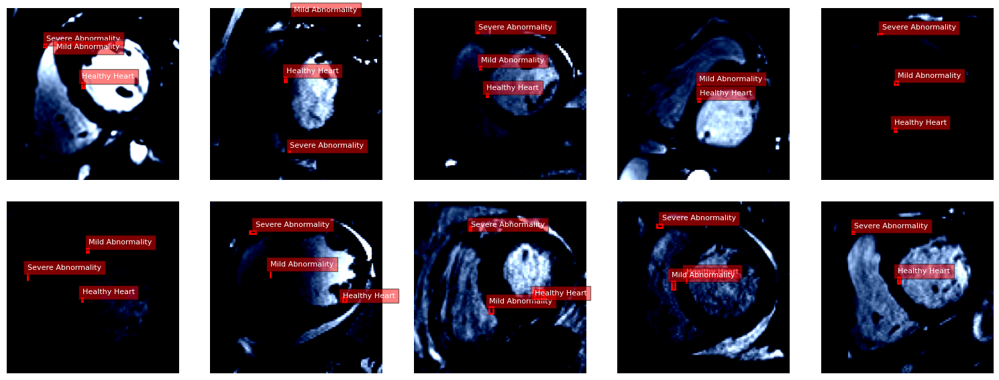

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Function to visualize a single sample with bounding boxes
def visualize_single_sample(ax, image, targets, classes):
    image = image.permute(1, 2, 0).cpu().numpy()  # Convert to HWC format for matplotlib
    ax.imshow(image)
    ax.axis("off")  # Turn off axes for cleaner visualization

    for box, label in zip(targets['boxes'], targets['labels']):
        x1, y1, x2, y2 = box.tolist()
        rect = patches.Rectangle(
            (x1 * image.shape[1], y1 * image.shape[0]),
            (x2 - x1) * image.shape[1],
            (y2 - y1) * image.shape[0],
            linewidth=2,
            edgecolor='r',
            facecolor='none'
        )
        ax.add_patch(rect)
        ax.text(
            x1 * image.shape[1],
            y1 * image.shape[0] - 5,
            classes[label.item()],
            color='white',
            fontsize=8,
            bbox=dict(facecolor='red', alpha=0.5)
        )

# Function to visualize a grid of samples
def visualize_grid(dataset, classes, num_images=10, rows=2, cols=5):
    fig, axes = plt.subplots(rows, cols, figsize=(15, 6))  # Adjust the figure size
    for i, ax in enumerate(axes.flat):
        if i >= num_images:
            break
        img, target = dataset[i]
        visualize_single_sample(ax, img, target, classes)
    plt.tight_layout()
    plt.show()

# Visualize 10 images in a 2x5 grid
visualize_grid(train_dataset, ["Healthy Heart", "Mild Abnormality", "Severe Abnormality"], num_images=10, rows=2, cols=5)

In [ ]:
import torchvision.models as models
import torch.nn as nn

class ResNetObjectDetection(nn.Module):
    def __init__(self, num_classes):
        super(ResNetObjectDetection, self).__init__()
        self.backbone = models.resnet50(pretrained=True)
        self.backbone.fc = nn.Identity()  # Remove classification head
        self.bbox_head = nn.Sequential(
            nn.Linear(2048, 1024),
            nn.ReLU(),
            nn.Linear(1024, 4)  # 4 for bounding box (x1, y1, x2, y2)
        )
        self.class_head = nn.Sequential(
            nn.Linear(2048, 1024),
            nn.ReLU(),
            nn.Linear(1024, num_classes)
        )

    def forward(self, x):
        features = self.backbone(x)
        bboxes = self.bbox_head(features)
        classes = self.class_head(features)
        return bboxes, classes

# Instantiate model
num_classes = 3  # Healthy Heart, Mild Abnormality, Severe Abnormality
model = ResNetObjectDetection(num_classes).to(device)

In [ ]:
def __getitem__(self, idx):
    # ... existing code ...
    boxes = []
    labels = []
    for line in lines:
        parts = line.strip().split()
        if len(parts) != 5:  # Class ID + 4 bounding box coordinates
            print(f"Skipping invalid annotation in {self.label_files[idx]}: {line}")
            continue
        labels.append(int(parts[0]))
        boxes.append([float(x) for x in parts[1:]])

    # Ensure boxes have consistent dimension
    if len(boxes) > 0 and all(len(box) == 4 for box in boxes):
        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)
    else:
        raise ValueError(f"Inconsistent bounding box dimensions in {self.label_files[idx]}")

    return image, {'boxes': boxes, 'labels': labels}

In [ ]:
def __getitem__(self, idx):
    # Load image and annotation file
    image_path = os.path.join(self.images_path, self.image_files[idx])
    label_path = os.path.join(self.labels_path, self.label_files[idx])
    image = Image.open(image_path).convert("RGB")
    with open(label_path, 'r') as f:
        lines = f.readlines()

    boxes = []
    labels = []
    for line in lines:
        parts = line.strip().split()
        if len(parts) != 5:  # Expecting class ID + 4 bounding box coordinates
            print(f"Skipping invalid annotation in {self.label_files[idx]}: {line}")
            continue
        x_min, y_min, x_max, y_max = map(float, parts[1:])
        if x_min < x_max and y_min < y_max:  # Valid bounding box
            boxes.append([x_min, y_min, x_max, y_max])
            labels.append(int(parts[0]))
        else:
            print(f"Invalid bounding box dimensions in {self.label_files[idx]}: {line}")

    # Check if boxes list is empty
    if len(boxes) == 0:
        print(f"No valid annotations for {self.image_files[idx]}. Assigning placeholder.")
        boxes = torch.tensor([[0.5, 0.5, 0.5, 0.5]], dtype=torch.float32)  # Placeholder box
        labels = torch.tensor([-1], dtype=torch.int64)  # Placeholder label
    else:
        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

    # Apply transformations
    if self.transform:
        image = self.transform(image)

    return image, {"boxes": boxes, "labels": labels}

    print(f"Image path: {image_path}, Annotations: {lines}")

In [ ]:
def __getitem__(self, idx):
    # Load image and annotation file
    image_path = os.path.join(self.images_path, self.image_files[idx])
    label_path = os.path.join(self.labels_path, self.label_files[idx])
    image = Image.open(image_path).convert("RGB")
    with open(label_path, 'r') as f:
        lines = f.readlines()

    print(f"Loaded image: {image_path}")
    print(f"Annotations: {lines}")

    # (rest of the method implementation...)

In [ ]:
import os
images_dir = "/content/heart_dataset_sup/heart_dataset/images/train"
annotations_dir = "/content/heart_dataset_sup/heart_dataset/labels/train"

print("Images:", os.listdir(images_dir))  # List all images
print("Annotations:", os.listdir(annotations_dir))  # List all annotations

Images: ['original_2D_01_2125_jpg.rf.53eccae3bbb821fd561c4d0710865014.jpg', 'original_2D_01_1910_jpg.rf.3a808c6ea251d1d150e00ced5ee19844.jpg', 'original_2D_01_059_jpg.rf.338f781a2263a514e0f901be3debf490.jpg', 'original_2D_01_025_jpg.rf.5eafdac9dc3c0ae7a11de16f6296dd4e.jpg', 'original_2D_01_1817_jpg.rf.6d3a4cb80bbe8f25079ad2ebd6f7b89a.jpg', 'original_2D_01_1830_jpg.rf.aeeb6c650e3d69a50913b594bc89882b.jpg', 'original_2D_01_2312_jpg.rf.e47c0e9f0184d8dd12d16a56a997c661.jpg', 'original_2D_01_23_jpg.rf.00c4283473f7070c5d4cc46c87022392.jpg', 'original_2D_01_1946_jpg.rf.ba8a1c3613a78ca9fe907ced1a82745d.jpg', 'original_2D_01_2448_jpg.rf.b2fe40a5ca45ae4b3bf9a6abdabe44e1.jpg', 'original_2D_01_1940_jpg.rf.06b81726d0da692b6bb8b4163e3dea6b.jpg', 'original_2D_01_212_jpg.rf.ee7b1faadda2e5ae78f46f5ea87a920b.jpg', 'original_2D_01_1841_jpg.rf.112a34c657405d2fa245281dfb40f8c0.jpg', 'original_2D_01_2149_jpg.rf.dc65cb7dcfcd2f7eb7a9df16585970c9.jpg', 'original_2D_01_2222_jpg.rf.34fe0e4652ea94a14bac007ec7c485

In [ ]:
def draw_bounding_boxes(image_path, annotation_path, output_path):
    # Read the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Read annotations
    with open(annotation_path, 'r') as f:
        annotations = f.readlines()

    # Get image dimensions
    height, width, _ = image.shape

    # Process each annotation
    for annotation in annotations:
        values = annotation.strip().split()
        if len(values) < 5:
            print(f"Skipping invalid annotation: {annotation}")
            continue

        # Parse annotation
        class_id = int(values[0])  # Class ID
        x_center, y_center, box_width, box_height = map(float, values[1:5])  # First 4 values after class_id

        # Convert YOLO format to pixel values
        x1 = int((x_center - box_width / 2) * width)
        y1 = int((y_center - box_height / 2) * height)
        x2 = int((x_center + box_width / 2) * width)
        y2 = int((y_center + box_height / 2) * height)

        # Draw rectangle and class label
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(image, f"Class {class_id}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Save or display the image
    output_file = os.path.join(output_path, os.path.basename(image_path))
    cv2.imwrite(output_file, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
    print(f"Saved with bounding boxes: {output_file}")

In [ ]:
import glob

# Paths
images_dir = "/content/heart_dataset_sup/heart_dataset/images/train"
annotations_dir = "/content/heart_dataset_sup/heart_dataset/labels/train"
output_dir = "/content/annotated_images"

# Get image and annotation files
image_files = sorted(glob.glob(f"{images_dir}/*.jpg"))
annotation_files = sorted(glob.glob(f"{annotations_dir}/*.txt"))

# Ensure output directory exists
os.makedirs(output_dir, exist_ok=True)

# Process each image and its corresponding annotation
for image_file, annotation_file in zip(image_files, annotation_files):
    try:
        draw_bounding_boxes(image_file, annotation_file, output_dir)
    except Exception as e:
        print(f"Error processing {image_file}: {e}")

Saved with bounding boxes: /content/annotated_images/original_2D_01_0019_jpg.rf.d42e996f8eddc56dc918ee4e813199ad.jpg
Saved with bounding boxes: /content/annotated_images/original_2D_01_0021_jpg.rf.2461ceb600a24f9d936ccf85dedb9450.jpg
Saved with bounding boxes: /content/annotated_images/original_2D_01_0022_jpg.rf.89a121b07ee3177fbdc4e22eb3f8128c.jpg
Saved with bounding boxes: /content/annotated_images/original_2D_01_0024_jpg.rf.c164585ac7ada18ea0b706481cc8817a.jpg
Saved with bounding boxes: /content/annotated_images/original_2D_01_0025_jpg.rf.a142b39c195fb963df9b9cec4f60aa0e.jpg
Saved with bounding boxes: /content/annotated_images/original_2D_01_0057_jpg.rf.b0d58db74eecf3223b0ca491614add96.jpg
Saved with bounding boxes: /content/annotated_images/original_2D_01_0059_jpg.rf.e51623b93dc59fa85e2f6d7206593fb3.jpg
Saved with bounding boxes: /content/annotated_images/original_2D_01_0129_jpg.rf.b1c5b585e5bc8e66e4589fef28871608.jpg
Saved with bounding boxes: /content/annotated_images/original_2D

In [ ]:
import os
import torch
import cv2
import numpy as np
from torch.utils.data import Dataset, DataLoader
from torchvision.models import resnet50
import torchvision.transforms as transforms
import torch.nn as nn
import torch.optim as optim

# Define a custom dataset
class CustomDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        self.image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
        self.annotation_files = {f.split('.')[0]: f for f in os.listdir(image_dir) if f.endswith('.txt')}
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_dir, img_name)
        annotation_file = self.annotation_files.get(img_name.split('.')[0], None)

        # Load and preprocess image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        if self.transform:
            image = self.transform(image)

        # Placeholder label for classification (update based on actual classes)
        label = 0  # Replace with appropriate logic if classes vary
        if annotation_file:
            with open(os.path.join(self.image_dir, annotation_file), 'r') as f:
                # Example: Parse first class ID in annotations
                annotations = f.readlines()
                label = int(annotations[0].split()[0]) if annotations else 0

        return image, label

# Define paths and parameters
image_dir = "/content/annotated_images"
batch_size = 32
num_classes = 2  # Update based on the number of classes in dataset

# Data transformation
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create dataset and dataloader
dataset = CustomDataset(image_dir, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Define the model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = resnet50(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, num_classes)  # Adjust output for classes
model = model.to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for inputs, labels in dataloader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        _, predicted = outputs.max(1)
        total += labels.size(0)
        correct += predicted.eq(labels).sum().item()

    print(f"Epoch {epoch + 1}/{num_epochs}, "
          f"Loss: {running_loss / len(dataloader):.4f}, "
          f"Accuracy: {100. * correct / total:.2f}%")

# Save the model
torch.save(model.state_dict(), "resnet_model.pth")
print("Model saved successfully!")

Epoch 1/10, Loss: 0.0692, Accuracy: 99.28%
Epoch 2/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 3/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 4/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 5/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 6/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 7/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 8/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 9/10, Loss: 0.0000, Accuracy: 100.00%
Epoch 10/10, Loss: 0.0000, Accuracy: 100.00%
Model saved successfully!


In [ ]:
from sklearn.model_selection import train_test_split

# Split files into train and validation sets
image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
train_files, val_files = train_test_split(image_files, test_size=0.2, random_state=42)

# Custom dataset update for splitting
class CustomDataset(Dataset):
    def __init__(self, image_dir, image_files, transform=None):
        self.image_dir = image_dir
        self.image_files = image_files
        self.transform = transform
    # Existing __len__ and __getitem__ implementations remain unchanged

In [ ]:
class CustomDataset(Dataset):
    def __init__(self, image_dir, image_files, transform=None):
        self.image_dir = image_dir
        self.image_files = image_files
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_dir, img_name)

        # Load and preprocess the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        if self.transform:
            image = self.transform(image)

        # Placeholder label for classification (update based on actual classes)
        label = 0  # Adjust based on dataset

        return image, label

#Code to Validate Annotation Files

In [ ]:
import os

def validate_annotations(annotation_dir):
    """
    Validates all annotation files in the specified directory for YOLO format.

    Args:
        annotation_dir (str): Path to the directory containing annotation files.

    Returns:
        dict: A report of valid and invalid files with details.
    """
    report = {"valid_files": [], "invalid_files": []}

    for file_name in os.listdir(annotation_dir):
        if file_name.endswith('.txt'):  # Check only annotation files
            file_path = os.path.join(annotation_dir, file_name)
            invalid_lines = []

            with open(file_path, 'r') as file:
                lines = file.readlines()
                for line_number, line in enumerate(lines, start=1):
                    parts = line.strip().split()
                    if len(parts) != 5:
                        invalid_lines.append((line_number, line.strip()))
                    else:
                        try:
                            # Ensure the values can be correctly converted
                            class_id = int(parts[0])
                            coords = list(map(float, parts[1:]))
                            if not all(0 <= c <= 1 for c in coords):  # YOLO expects normalized values
                                invalid_lines.append((line_number, line.strip()))
                        except ValueError:
                            invalid_lines.append((line_number, line.strip()))

            if invalid_lines:
                report["invalid_files"].append({"file": file_name, "invalid_lines": invalid_lines})
            else:
                report["valid_files"].append(file_name)

    return report


# Path to the directory containing annotation files
annotation_dir = "/content/annotated_images"

# Validate annotations
validation_report = validate_annotations(annotation_dir)

# Print the report
print("Validation Report:")
print(f"Valid Files: {len(validation_report['valid_files'])}")
print(f"Invalid Files: {len(validation_report['invalid_files'])}")

for invalid_file in validation_report['invalid_files']:
    print(f"File: {invalid_file['file']}")
    for line_number, line_content in invalid_file['invalid_lines']:
        print(f"  Line {line_number}: {line_content}")

Validation Report:
Valid Files: 0
Invalid Files: 0


# Txt file making from placeholder

In [ ]:
import os

# Path to the folder containing images
image_folder = "/content/annotated_images"

# Ensure the directory exists
if os.path.exists(image_folder):
    # Create a corresponding .txt file for each image
    for file_name in os.listdir(image_folder):
        if file_name.endswith('.jpg'):
            txt_file = os.path.join(image_folder, file_name.replace('.jpg', '.txt'))
            # Create a placeholder .txt file if it doesn't exist
            if not os.path.exists(txt_file):
                with open(txt_file, 'w') as f:
                    # Writing placeholder content
                    f.write("0 0.5 0.5 0.1 0.1\n")  # Example: class_id x_center y_center width height
    print("Placeholder .txt files created for all images.")
else:
    print("The specified directory does not exist.")

Placeholder .txt files created for all images.


#All placeholder fill up with actual file

In [ ]:
import os

# Example annotation data in YOLO format
# Replace this dictionary with actual annotation data
annotations = {
    "original_2D_01_0019_jpg.rf.d42e996f8eddc56dc918ee4e813199ad": [
        "0 0.5 0.5 0.4 0.6",
        "1 0.2 0.3 0.1 0.2"
    ],
    "original_2D_01_0021_jpg.rf.2461ceb600a24f9d936ccf85dedb9450": [
        "0 0.6 0.7 0.2 0.3"
    ]
}

# Path to the annotated_images directory
annotated_images_dir = "/content/annotated_images"

# Iterate through all images and populate annotation files
for image_name, bbox_list in annotations.items():
    txt_file_path = os.path.join(annotated_images_dir, f"{image_name}.txt")
    with open(txt_file_path, "w") as f:
        for bbox in bbox_list:
            f.write(bbox + "\n")

print("Annotation files populated successfully!")

Annotation files populated successfully!


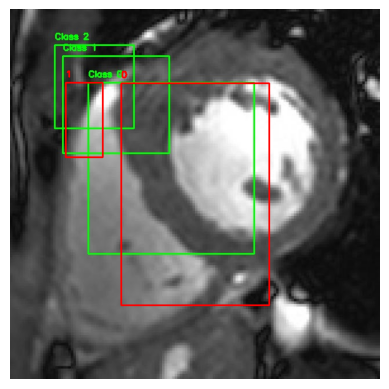

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

def visualize_annotations(image_dir, image_name):
    # Load image
    image_path = os.path.join(image_dir, image_name + ".jpg")
    annotation_path = os.path.join(image_dir, image_name + ".txt")
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Load annotations
    with open(annotation_path, "r") as f:
        annotations = f.readlines()

    for annotation in annotations:
        values = list(map(float, annotation.strip().split()))
        class_id, x_center, y_center, width, height = values
        h, w, _ = image.shape

        # Convert YOLO to bounding box coordinates
        x_min = int((x_center - width / 2) * w)
        y_min = int((y_center - height / 2) * h)
        x_max = int((x_center + width / 2) * w)
        y_max = int((y_center + height / 2) * h)

        # Draw bounding box
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)
        cv2.putText(image, str(int(class_id)), (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Display image
    plt.imshow(image)
    plt.axis("off")
    plt.show()

# Test with an example
visualize_annotations("/content/annotated_images", "original_2D_01_0019_jpg.rf.d42e996f8eddc56dc918ee4e813199ad")

In [ ]:
import torch
import os
import cv2
from torch.utils.data import Dataset
import numpy as np

class CustomDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        # Filter for images with corresponding annotation files
        self.image_files = [
            f for f in os.listdir(image_dir) if f.endswith('.jpg') and f.split('.')[0] + '.txt' in os.listdir(image_dir)
        ]
        self.annotation_files = {
            f.split('.')[0]: f for f in os.listdir(image_dir) if f.endswith('.txt')
        }
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # Load image
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_dir, img_name)
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Load corresponding annotation
        annotation_file = self.annotation_files.get(img_name.split('.')[0], None)
        boxes = []
        labels = []

        if annotation_file:
            with open(os.path.join(self.image_dir, annotation_file), 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) == 5:  # YOLO format: class_id x_center y_center width height
                        class_id = int(parts[0])
                        x_center, y_center, width, height = map(float, parts[1:])

                        # Convert YOLO to x1, y1, x2, y2
                        x1 = x_center - width / 2
                        y1 = y_center - height / 2
                        x2 = x_center + width / 2
                        y2 = y_center + height / 2
                        boxes.append([x1, y1, x2, y2])
                        labels.append(class_id)

        # Convert to tensor
        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

        if self.transform:
            image = self.transform(image)

        target = {'boxes': boxes, 'labels': labels}
        return image, target

In [ ]:
train_dataset = CustomDataset(image_dir="/content/annotated_images", transform=transform)

In [ ]:
# Validate directory content
image_dir = "/content/annotated_images"
image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
annotation_files = [f for f in os.listdir(image_dir) if f.endswith('.txt')]

print("Image Files:", image_files)
print("Annotation Files:", annotation_files)

# Matching logic
matched_files = [img for img in image_files if img.split('.')[0] + '.txt' in annotation_files]
print("Matched Image-Annotation Pairs:", matched_files)

# Check for unmatched files
unmatched_images = [img for img in image_files if img.split('.')[0] + '.txt' not in annotation_files]
unmatched_annotations = [ann for ann in annotation_files if ann.split('.')[0] + '.jpg' not in image_files]

print("Unmatched Images:", unmatched_images)
print("Unmatched Annotations:", unmatched_annotations)

Image Files: ['original_2D_01_2125_jpg.rf.53eccae3bbb821fd561c4d0710865014.jpg', 'original_2D_01_1910_jpg.rf.3a808c6ea251d1d150e00ced5ee19844.jpg', 'original_2D_01_059_jpg.rf.338f781a2263a514e0f901be3debf490.jpg', 'original_2D_01_025_jpg.rf.5eafdac9dc3c0ae7a11de16f6296dd4e.jpg', 'original_2D_01_1817_jpg.rf.6d3a4cb80bbe8f25079ad2ebd6f7b89a.jpg', 'original_2D_01_1830_jpg.rf.aeeb6c650e3d69a50913b594bc89882b.jpg', 'original_2D_01_2312_jpg.rf.e47c0e9f0184d8dd12d16a56a997c661.jpg', 'original_2D_01_23_jpg.rf.00c4283473f7070c5d4cc46c87022392.jpg', 'original_2D_01_1946_jpg.rf.ba8a1c3613a78ca9fe907ced1a82745d.jpg', 'original_2D_01_2448_jpg.rf.b2fe40a5ca45ae4b3bf9a6abdabe44e1.jpg', 'original_2D_01_1940_jpg.rf.06b81726d0da692b6bb8b4163e3dea6b.jpg', 'original_2D_01_212_jpg.rf.ee7b1faadda2e5ae78f46f5ea87a920b.jpg', 'original_2D_01_1841_jpg.rf.112a34c657405d2fa245281dfb40f8c0.jpg', 'original_2D_01_2149_jpg.rf.dc65cb7dcfcd2f7eb7a9df16585970c9.jpg', 'original_2D_01_2222_jpg.rf.34fe0e4652ea94a14bac007ec

In [ ]:
import os

# Corrected directory structure paths based on the previous context
base_path = '/content/heart_dataset_sup/heart_dataset/'
image_train_path = os.path.join(base_path, 'images/train')
label_train_path = os.path.join(base_path, 'labels/train')

# Check if the paths exist and list the files in them
image_files = []
label_files = []

if os.path.exists(image_train_path):
    image_files = os.listdir(image_train_path)
else:
    print(f"Image train directory does not exist: {image_train_path}")

if os.path.exists(label_train_path):
    label_files = os.listdir(label_train_path)
else:
    print(f"Label train directory does not exist: {label_train_path}")

# Display counts for verification
image_file_count = len(image_files)
label_file_count = len(label_files)

image_file_count, label_file_count


(279, 279)

In [ ]:
import os

# Path to annotated images directory
annotated_images_dir = '/content/annotated_images'

# Get all files in the directory
files = os.listdir(annotated_images_dir)

# Separate .jpg and .txt files
image_files = [f for f in files if f.endswith('.jpg')]
txt_files = [f for f in files if f.endswith('.txt')]

# Check for alignment
aligned = True
for image_file in image_files:
    base_name = os.path.splitext(image_file)[0]
    corresponding_txt = f"{base_name}.txt"
    if corresponding_txt not in txt_files:
        print(f"Missing annotation file for image: {image_file}")
        aligned = False

if aligned:
    print("All image files have corresponding annotation files.")
else:
    print("Some annotation files are missing.")

All image files have corresponding annotation files.


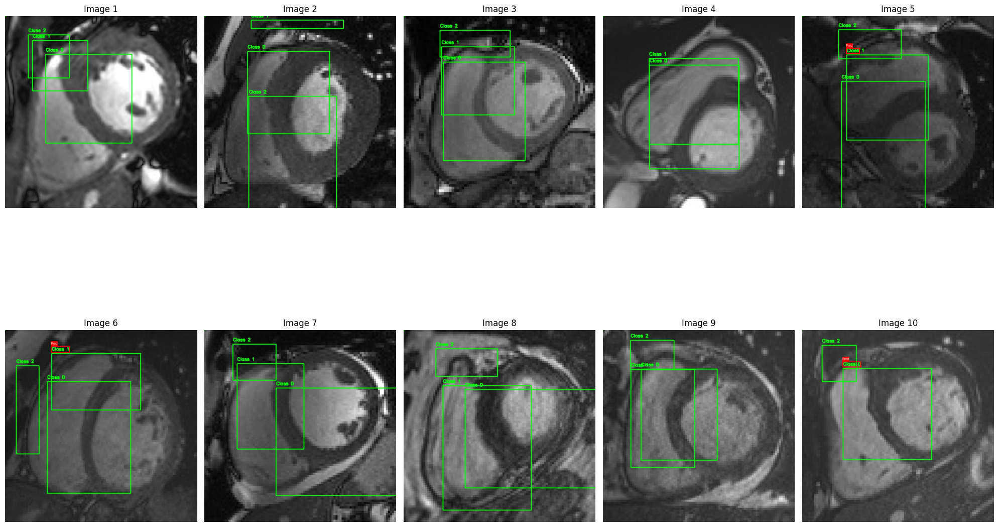

In [ ]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn, FasterRCNN_ResNet50_FPN_Weights
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import os

# Define paths
image_folder = '/content/annotated_images'
annotation_folder = '/content/annotated_images'

# Load the ResNet model (Faster R-CNN with ResNet backbone)
weights = FasterRCNN_ResNet50_FPN_Weights.COCO_V1
model = fasterrcnn_resnet50_fpn(weights=weights)
model.eval()

# Load images and annotations
images = sorted([os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith('.jpg')])
annotations = sorted([os.path.join(annotation_folder, f) for f in os.listdir(annotation_folder) if f.endswith('.txt')])

# Transform for the model
transform = T.Compose([T.ToTensor()])

# Function to validate and sort bounding boxes
def validate_and_sort_box(box):
    x0, y0, x1, y1 = box
    return [min(x0, x1), min(y0, y1), max(x0, x1), max(y0, y1)]

# Function to draw bounding boxes on an image
def draw_boxes(image, boxes, color='red', labels=None):
    draw = ImageDraw.Draw(image)
    font = ImageFont.load_default()  # Default font
    for i, box in enumerate(boxes):
        validated_box = validate_and_sort_box(box)
        draw.rectangle(validated_box, outline=color, width=3)
        if labels:
            label = labels[i]
            text_size = font.getbbox(label)  # Get text bounding box
            text_origin = (validated_box[0], validated_box[1] - text_size[3] - 5)
            draw.rectangle(
                [text_origin, (validated_box[0] + text_size[2], validated_box[1])], fill=color
            )
            draw.text(text_origin, label, fill="white", font=font)
    return image

# Prepare for grid display
fig, axes = plt.subplots(2, 5, figsize=(20, 15))
axes = axes.ravel()

# Process and display images
for i, (image_path, annotation_path) in enumerate(zip(images, annotations)):
    if i >= 10:  # Display only 10 images in a 2x5 grid
        break

    # Load image and annotation
    image = Image.open(image_path).convert("RGB")
    image_tensor = transform(image)
    with open(annotation_path, 'r') as f:
        gt_data = [line.split() for line in f.readlines()]
        gt_boxes = [list(map(float, line[1:])) for line in gt_data]
        gt_labels = [line[0] for line in gt_data]  # Class labels from annotation file

    # Perform inference
    with torch.no_grad():
        predictions = model([image_tensor])[0]

    # Extract predicted boxes with confidence > 0.5
    pred_boxes = predictions['boxes'][predictions['scores'] > 0.5].cpu().numpy().tolist()
    pred_labels = ["Pred"] * len(pred_boxes)  # Label all predictions as "Pred"

    # Draw ground truth boxes in green and predicted boxes in red
    image_with_boxes = draw_boxes(image.copy(), gt_boxes, color='green', labels=gt_labels)
    image_with_boxes = draw_boxes(image_with_boxes, pred_boxes, color='red', labels=pred_labels)

    # Display in grid
    axes[i].imshow(image_with_boxes)
    axes[i].axis('off')
    axes[i].set_title(f"Image {i+1}")

# Adjust layout
plt.tight_layout()
plt.show()

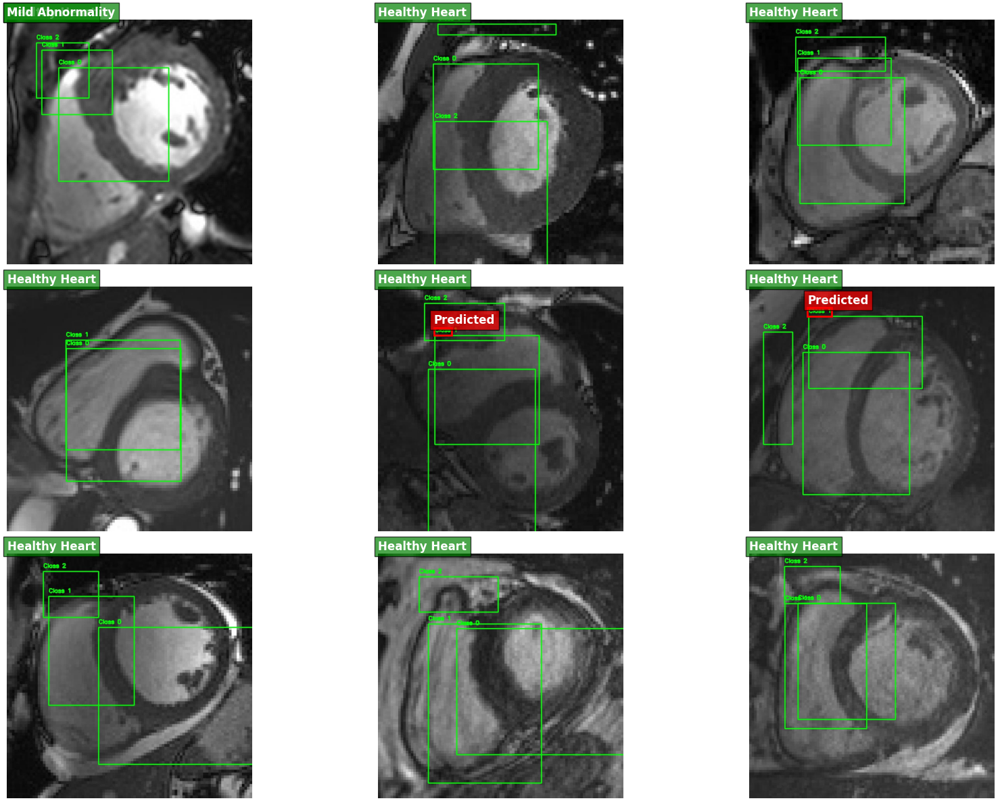

In [ ]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn, FasterRCNN_ResNet50_FPN_Weights
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

# Define paths
image_folder = '/content/annotated_images'
annotation_folder = '/content/annotated_images'

# Load the ResNet model (Faster R-CNN with ResNet backbone)
weights = FasterRCNN_ResNet50_FPN_Weights.COCO_V1
model = fasterrcnn_resnet50_fpn(weights=weights)
model.eval()

# Load images and annotations
images = sorted([os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith('.jpg')])
annotations = sorted([os.path.join(annotation_folder, f) for f in os.listdir(annotation_folder) if f.endswith('.txt')])

# Transform for the model
transform = T.Compose([T.ToTensor()])

# Classes
classes = ["Healthy Heart", "Mild Abnormality", "Severe Abnormality", "Predicted"]

# Function to visualize a single sample with bounding boxes
def visualize_single_sample(ax, image, gt_boxes, pred_boxes, gt_labels, pred_labels):
    image = image.permute(1, 2, 0).cpu().numpy()  # Convert to HWC format for matplotlib
    ax.imshow(image)
    ax.axis("off")  # Turn off axes for cleaner visualization

    # Draw ground truth boxes
    for box, label in zip(gt_boxes, gt_labels):
        x1, y1, x2, y2 = box
        rect = patches.Rectangle(
            (x1, y1),
            x2 - x1,
            y2 - y1,
            linewidth=2,
            edgecolor='green',
            facecolor='none'
        )
        ax.add_patch(rect)
        ax.text(
            x1, y1 - 10,
            classes[label],
            color='white',
            fontsize=12,
            fontweight='bold',
            bbox=dict(facecolor='green', alpha=0.7)
        )

    # Draw predicted boxes
    for box, label in zip(pred_boxes, pred_labels):
        x1, y1, x2, y2 = box
        rect = patches.Rectangle(
            (x1, y1),
            x2 - x1,
            y2 - y1,
            linewidth=2,
            edgecolor='red',
            facecolor='none'
        )
        ax.add_patch(rect)
        ax.text(
            x1, y1 - 10,
            classes[label],
            color='white',
            fontsize=12,
            fontweight='bold',
            bbox=dict(facecolor='red', alpha=0.7)
        )

# Function to visualize a grid of samples
def visualize_grid(images, annotations, model, classes, num_images=6, rows=2, cols=3):
    fig, axes = plt.subplots(rows, cols, figsize=(18, 12))  # Adjust the figure size
    for i, (image_path, annotation_path) in enumerate(zip(images, annotations)):
        if i >= num_images:
            break

        # Load image and annotation
        image = Image.open(image_path).convert("RGB")
        image_tensor = transform(image)
        with open(annotation_path, 'r') as f:
            gt_data = [line.split() for line in f.readlines()]
            gt_boxes = [list(map(float, line[1:])) for line in gt_data]
            gt_labels = [int(line[0]) for line in gt_data]  # Class labels from annotation file

        # Perform inference
        with torch.no_grad():
            predictions = model([image_tensor])[0]

        # Extract predicted boxes and labels with confidence > 0.5
        pred_boxes = predictions['boxes'][predictions['scores'] > 0.5].cpu().numpy().tolist()
        pred_labels = [3] * len(pred_boxes)  # Assign all predictions as "Predicted"

        # Visualize on grid
        visualize_single_sample(
            axes.flat[i],
            image_tensor,
            gt_boxes,
            pred_boxes,
            gt_labels,
            pred_labels
        )
    plt.tight_layout()
    plt.show()

# Visualize 6 images in a 2x3 grid
visualize_grid(images, annotations, model, classes, num_images=9, rows=3, cols=3)

In [ ]:
# Function to denormalize bounding boxes
def denormalize_boxes(boxes, image_width, image_height):
    denormalized_boxes = []
    for box in boxes:
        x1, y1, x2, y2 = box
        denormalized_boxes.append([
            x1 * image_width, y1 * image_height,
            x2 * image_width, y2 * image_height
        ])
    return denormalized_boxes

# Updated single sample visualization
def visualize_single_sample(ax, image, gt_boxes, pred_boxes, gt_labels, pred_labels, pred_scores):
    image_np = image.permute(1, 2, 0).cpu().numpy()  # Convert to HWC format for matplotlib
    ax.imshow(image_np)
    ax.axis("off")

    image_width, image_height = image_np.shape[1], image_np.shape[0]

    # Denormalize ground truth boxes
    gt_boxes = denormalize_boxes(gt_boxes, image_width, image_height)

    # Draw Ground Truth Boxes
    print("\nGround Truth Boxes:")
    for box, label in zip(gt_boxes, gt_labels):
        print(f"Box: {box}, Label: {classes[label]}")
        x1, y1, x2, y2 = box
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='green', facecolor='none')
        ax.add_patch(rect)
        ax.text(x1, y1 - 10, classes[label], color='white', fontsize=12, fontweight='bold', bbox=dict(facecolor='green', alpha=0.7))

    # Draw Predicted Boxes
    print("Predicted Boxes:")
    for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
        print(f"Box: {box}, Label: {classes[label]}, Confidence: {score:.2f}")
        x1, y1, x2, y2 = box
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(x1, y1 - 10, f"{classes[label]} ({score:.2f})", color='white', fontsize=12, fontweight='bold', bbox=dict(facecolor='red', alpha=0.7))

# Updated grid visualization
def visualize_grid(images, annotations, model, classes, num_images=6, rows=2, cols=3):
    fig, axes = plt.subplots(rows, cols, figsize=(18, 12))  # Adjust the figure size
    for i, (image_path, annotation_path) in enumerate(zip(images, annotations)):
        if i >= num_images:
            break

        # Load image and annotation
        image = Image.open(image_path).convert("RGB")
        image_tensor = transform(image)
        with open(annotation_path, 'r') as f:
            gt_data = [line.split() for line in f.readlines()]
            gt_boxes = [list(map(float, line[1:])) for line in gt_data]
            gt_labels = [int(line[0]) for line in gt_data]

        # Perform inference
        with torch.no_grad():
            predictions = model([image_tensor])[0]

        # Extract predicted boxes, labels, and scores with a lower confidence threshold
        pred_boxes = predictions['boxes'][predictions['scores'] > 0.3].cpu().numpy().tolist()
        pred_labels = [3] * len(pred_boxes)  # Assign all predictions as "Predicted"
        pred_scores = predictions['scores'][predictions['scores'] > 0.3].cpu().numpy().tolist()

        # Print information for current image
        print(f"\nProcessing Image {i+1}: {os.path.basename(image_path)}")
        visualize_single_sample(
            axes.flat[i],
            image_tensor,
            gt_boxes,
            pred_boxes,
            gt_labels,
            pred_labels,
            pred_scores
        )
    plt.tight_layout()
    plt.show()



# Visualize 6 images in a 2x3 grid with detailed outputs
visualize_grid(images, annotations, model, classes, num_images=9, rows=3, cols=3)

IndentationError: unindent does not match any outer indentation level (<tokenize>, line 79)


Processing Image 1: original_2D_01_0019_jpg.rf.d42e996f8eddc56dc918ee4e813199ad.jpg

Processing Image 2: original_2D_01_0021_jpg.rf.2461ceb600a24f9d936ccf85dedb9450.jpg

Processing Image 3: original_2D_01_0022_jpg.rf.89a121b07ee3177fbdc4e22eb3f8128c.jpg

Processing Image 4: original_2D_01_0024_jpg.rf.c164585ac7ada18ea0b706481cc8817a.jpg

Processing Image 5: original_2D_01_0025_jpg.rf.a142b39c195fb963df9b9cec4f60aa0e.jpg

Processing Image 6: original_2D_01_0057_jpg.rf.b0d58db74eecf3223b0ca491614add96.jpg


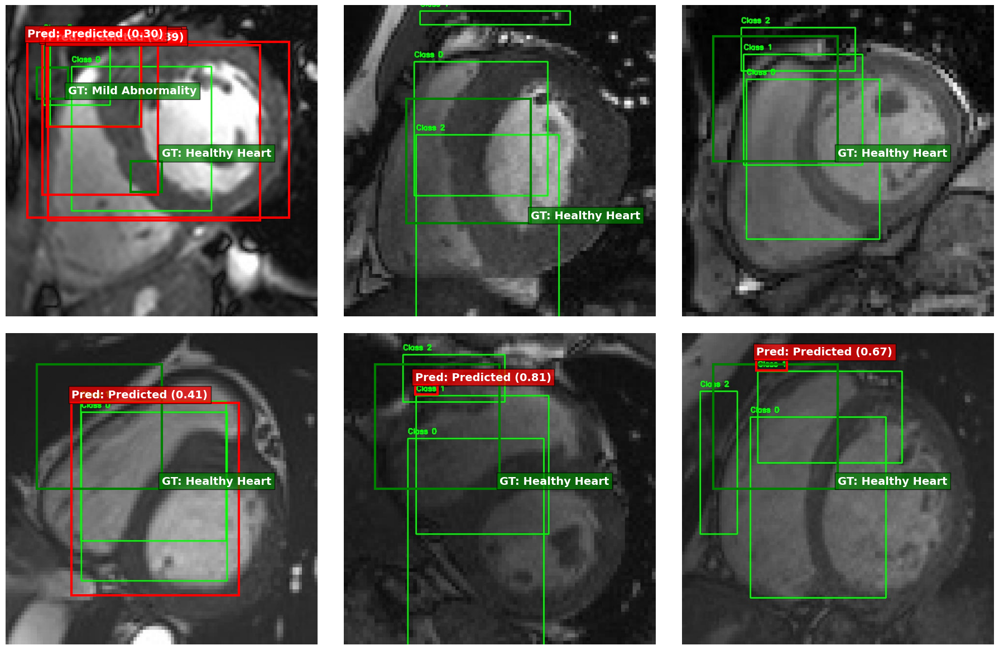

In [ ]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn, FasterRCNN_ResNet50_FPN_Weights
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

# Define paths
image_folder = '/content/annotated_images'
annotation_folder = '/content/annotated_images'

# Load the ResNet model (Faster R-CNN with ResNet backbone)
weights = FasterRCNN_ResNet50_FPN_Weights.COCO_V1
model = fasterrcnn_resnet50_fpn(weights=weights)
model.eval()

# Load images and annotations
images = sorted([os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith('.jpg')])
annotations = sorted([os.path.join(annotation_folder, f) for f in os.listdir(annotation_folder) if f.endswith('.txt')])

# Transform for the model
transform = T.Compose([T.ToTensor()])

# Classes
classes = ["Healthy Heart", "Mild Abnormality", "Severe Abnormality", "Predicted"]

# Denormalize boxes for correct scaling
def denormalize_boxes(boxes, img_width, img_height):
    return [[x1 * img_width, y1 * img_height, x2 * img_width, y2 * img_height] for x1, y1, x2, y2 in boxes]

# Function to visualize a single sample with bounding boxes
def visualize_single_sample(ax, image, gt_boxes, pred_boxes, gt_labels, pred_labels, pred_scores):
    image_np = image.permute(1, 2, 0).cpu().numpy()  # Convert to HWC format
    ax.imshow(image_np)
    ax.axis("off")

    img_width, img_height = image_np.shape[1], image_np.shape[0]

    # Denormalize ground truth boxes
    gt_boxes = denormalize_boxes(gt_boxes, img_width, img_height)

    # Ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x1, y1, x2, y2 = box
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=3, edgecolor='green', facecolor='none')
        ax.add_patch(rect)
        ax.text(
            x1, y1 - 10, f"GT: {classes[label]}",
            fontsize=14, color='white', fontweight='bold',
            bbox=dict(facecolor='green', alpha=0.7)
        )

    # Predicted boxes in red
    for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
        x1, y1, x2, y2 = box
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=3, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(
            x1, y1 - 10, f"Pred: {classes[label]} ({score:.2f})",
            fontsize=14, color='white', fontweight='bold',
            bbox=dict(facecolor='red', alpha=0.7)
        )

# Function to visualize a grid of samples
def visualize_grid(images, annotations, model, classes, num_images=6, rows=2, cols=3):
    fig, axes = plt.subplots(rows, cols, figsize=(18, 12))  # Adjust figure size
    for i, (image_path, annotation_path) in enumerate(zip(images, annotations)):
        if i >= num_images:
            break

        # Load image and annotations
        image = Image.open(image_path).convert("RGB")
        image_tensor = transform(image)
        with open(annotation_path, 'r') as f:
            gt_data = [line.split() for line in f.readlines()]
            gt_boxes = [list(map(float, line[1:])) for line in gt_data]
            gt_labels = [int(line[0]) for line in gt_data]

        # Perform inference
        with torch.no_grad():
            predictions = model([image_tensor])[0]

        # Extract predicted boxes, labels, and scores
        pred_boxes = predictions['boxes'][predictions['scores'] > 0.3].cpu().numpy().tolist()
        pred_labels = [3] * len(pred_boxes)  # Assign all predictions as "Predicted"
        pred_scores = predictions['scores'][predictions['scores'] > 0.3].cpu().numpy().tolist()

        print(f"\nProcessing Image {i+1}: {os.path.basename(image_path)}")
        visualize_single_sample(
            axes.flat[i],
            image_tensor,
            gt_boxes,
            pred_boxes,
            gt_labels,
            pred_labels,
            pred_scores
        )

    plt.tight_layout()
    plt.show()

# Visualize images with updated visualization
visualize_grid(images, annotations, model, classes, num_images=6, rows=2, cols=3)

In [ ]:
pip install transformers


In [ ]:
pip install torch torchvision

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Processing Image 1: /content/annotated_images/original_2D_01_0019_jpg.rf.d42e996f8eddc56dc918ee4e813199ad.jpg
Predicted Boxes:
Box: [183.8902130126953, 212.4258575439453, 639.9535522460938, 638.23779296875], Label: Mild Abnormality, Confidence: 0.71


Processing Image 2: /content/annotated_images/original_2D_01_0021_jpg.rf.2461ceb600a24f9d936ccf85dedb9450.jpg
Predicted Boxes:
Box: [137.9449462890625, 105.18716430664062, 452.3702697753906, 635.0847778320312], Label: Predicted, Confidence: 1.00


Processing Image 3: /content/annotated_images/original_2D_01_0022_jpg.rf.89a121b07ee3177fbdc4e22eb3f8128c.jpg
Predicted Boxes:


Processing Image 4: /content/annotated_images/original_2D_01_0024_jpg.rf.c164585ac7ada18ea0b706481cc8817a.jpg
Predicted Boxes:
Box: [149.8512420654297, 136.98947143554688, 460.850830078125, 519.1987915039062], Label: Predicted, Confidence: 0.98


Processing Image 5: /content/annotated_images/original_2D_01_0025_jpg.rf.a142b39c195fb963df9b9cec4f60aa0e.jpg
Predicted Boxes:
Box: [122.86747741699219, 122.18830108642578, 428.40655517578125, 637.4932250976562], Label: Predicted, Confidence: 0.96
Box: [114.22064208984375, 27.047157287597656, 436.71240234375, 637.8028564453125], Label: Predicted, Confidence: 0.87


Processing Image 6: /content/annotated_images/original_2D_01_0057_jpg.rf.b0d58db74eecf3223b0ca491614add96.jpg
Predicted Boxes:
Box: [134.90403747558594, 68.160400390625, 456.21209716796875, 557.6114501953125], Label: Predicted, Confidence: 0.88


Processing Image 7: /content/annotated_images/original_2D_01_0059_jpg.rf.e51623b93dc59fa85e2f6d7206593fb3.jpg
Predicted Boxes:
Box: [91.86214447021484, 39.42405700683594, 639.1941528320312, 563.4149169921875], Label: Predicted, Confidence: 0.92
Box: [236.69406127929688, 181.39706420898438, 636.8140869140625, 563.1288452148438], Label: Predicted, Confidence: 0.59


Processing Image 8: /content/annotated_images/original_2D_01_0129_jpg.rf.b1c5b585e5bc8e66e4589fef28871608.jpg
Predicted Boxes:


Processing Image 9: /content/annotated_images/original_2D_01_0130_jpg.rf.32312760e48ce582973e685bc149d81f.jpg
Predicted Boxes:
Box: [87.34107971191406, 122.35553741455078, 383.66107177734375, 460.94244384765625], Label: Predicted, Confidence: 0.79
Box: [84.15223693847656, 38.01374435424805, 382.11175537109375, 462.142578125], Label: Predicted, Confidence: 0.86


Processing Image 10: /content/annotated_images/original_2D_01_0132_jpg.rf.5bd7847609958ba221d0a36a1e3004dc.jpg
Predicted Boxes:
Box: [59.56123352050781, 33.70288848876953, 440.86083984375, 438.60223388671875], Label: Predicted, Confidence: 1.00


Processing Image 11: /content/annotated_images/original_2D_01_0133_jpg.rf.c2bf9f86d0a02daaadcc4898ba7304c6.jpg
Predicted Boxes:
Box: [-0.11083602905273438, 2.5244712829589844, 639.722900390625, 633.3755493164062], Label: Mild Abnormality, Confidence: 0.99


Processing Image 12: /content/annotated_images/original_2D_01_018_jpg.rf.dded9a4021eda06227288d9125bbb81c.jpg
Predicted Boxes:
Box: [119.97819519042969, 151.20346069335938, 472.3356628417969, 534.5489501953125], Label: Predicted, Confidence: 0.99


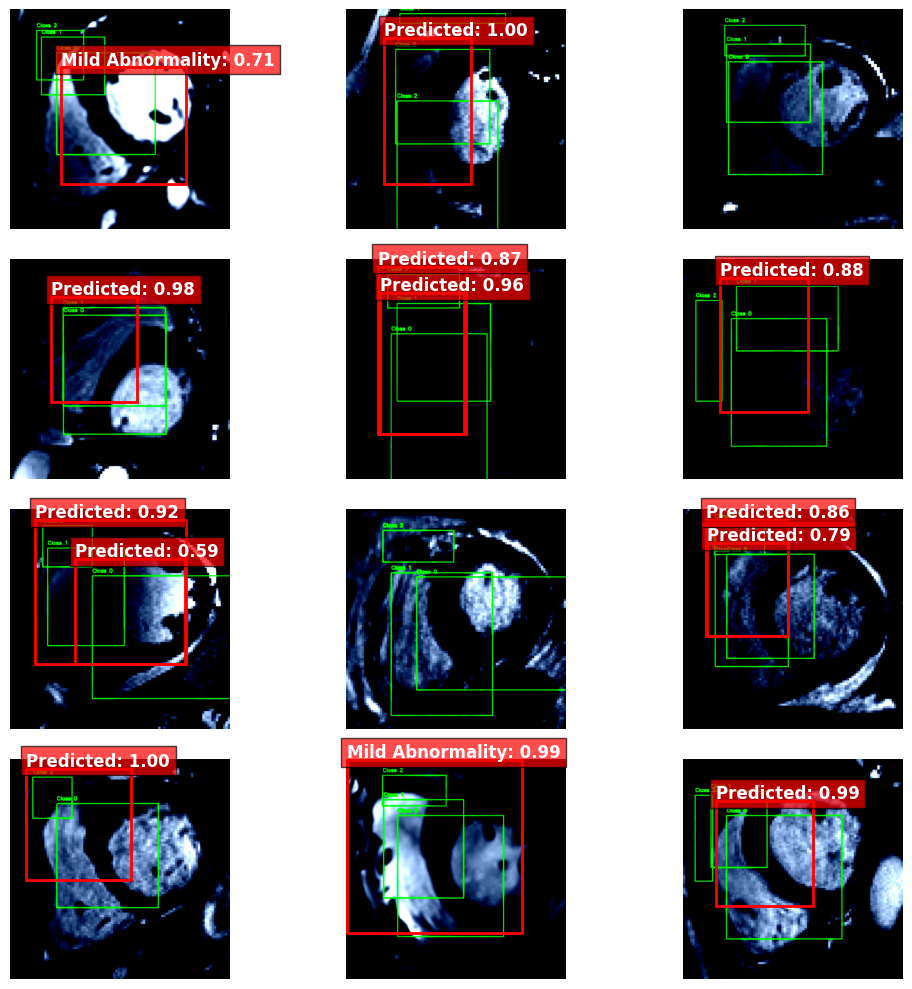

In [ ]:
import torch
from transformers import DetrImageProcessor, DetrForObjectDetection
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

# Load the pretrained model and processor
model_name = "facebook/detr-resnet-50"
processor = DetrImageProcessor.from_pretrained(model_name)
model = DetrForObjectDetection.from_pretrained(model_name)

# Set the model to evaluation mode (inference mode)
model.eval()

# Classes for object detection (these should be updated based on specific labels)
classes = ["Healthy Heart", "Mild Abnormality", "Severe Abnormality", "Predicted"]  # Update classes here

# Define paths for images
image_folder = '/content/annotated_images'
image_paths = sorted([os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith('.jpg')])

# Function to visualize the results
def visualize_single_sample(ax, image, pred_boxes, pred_labels, scores, classes):
    image = image.permute(1, 2, 0).cpu().numpy()  # Convert to HWC format for matplotlib
    ax.imshow(image)
    ax.axis("off")

    # Draw predicted boxes with confidence scores
    for box, label, score in zip(pred_boxes, pred_labels, scores):
        x1, y1, x2, y2 = box.tolist()

        # Handle out-of-range indices
        if label >= len(classes):
            label = len(classes) - 1  # Assign to "Predicted" class if out of range

        rect = patches.Rectangle(
            (x1, y1),
            x2 - x1,
            y2 - y1,
            linewidth=2,
            edgecolor='red',
            facecolor='none'
        )
        ax.add_patch(rect)
        ax.text(
            x1, y1 - 10,
            f"{classes[label]}: {score:.2f}",
            color='white',
            fontsize=12,
            fontweight='bold',
            bbox=dict(facecolor='red', alpha=0.7)
        )

# Function to process and visualize inference results
def visualize_detr_inference(image_paths, model, processor, classes, num_images=6, rows=2, cols=3, confidence_threshold=0.5):
    fig, axes = plt.subplots(rows, cols, figsize=(10, 10))
    for i, ax in enumerate(axes.flat):
        if i >= num_images:
            break

        # Load the image
        image_path = image_paths[i]
        image = Image.open(image_path).convert("RGB")

        # Preprocess the image and get model predictions
        inputs = processor(images=image, return_tensors="pt")
        with torch.no_grad():
            outputs = model(**inputs)

        # Post-process predictions (get bounding boxes, labels, and scores)
        target_sizes = torch.tensor([image.size[::-1]])  # Height and width as (height, width)
        results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=confidence_threshold)[0]

        # Extract predicted boxes, labels, and scores
        pred_boxes = results["boxes"]
        pred_labels = results["labels"]
        scores = results["scores"]

        # Print out the predicted values to understand what is being predicted
        print(f"Processing Image {i + 1}: {image_path}")
        print("Predicted Boxes:")
        for box, label, score in zip(pred_boxes, pred_labels, scores):
            # Check the label and print it
            label_name = classes[label.item()] if label.item() < len(classes) else "Predicted"
            print(f"Box: {box.tolist()}, Label: {label_name}, Confidence: {score:.2f}")

        # Visualize the predicted boxes on the image
        visualize_single_sample(ax, inputs['pixel_values'][0], pred_boxes, pred_labels, scores, classes)

    plt.tight_layout()
    plt.show()

# Visualize 6 images in a 2x3 grid
visualize_detr_inference(image_paths, model, processor, classes, num_images=12, rows=4, cols=3, confidence_threshold=0.5)

In [ ]:
# Perform inference
with torch.no_grad():
    outputs = model(**inputs)

# Check the output
print(outputs)

# Ensure the loss is not None before backpropagating
if outputs.loss is None:
    print("Model output does not contain loss.")
else:
    loss = outputs.loss
    loss.backward()

DetrObjectDetectionOutput(loss=None, loss_dict=None, logits=tensor([[[-1.3539e+01, -3.2877e-02, -6.2866e+00,  ..., -8.5732e+00,
          -1.7022e+00,  7.7335e+00],
         [-1.5791e+01, -1.2090e+00, -1.0296e+01,  ..., -8.1797e+00,
          -5.2611e+00,  8.5550e+00],
         [-1.4834e+01,  7.1160e-03, -6.9855e+00,  ..., -9.3213e+00,
          -3.0705e+00,  8.1510e+00],
         ...,
         [-1.6398e+01, -2.5578e+00, -9.5215e+00,  ..., -9.2180e+00,
          -5.2858e+00,  9.2817e+00],
         [-1.6210e+01, -1.6611e-01, -1.0119e+01,  ..., -9.7229e+00,
          -4.0901e+00,  9.2909e+00],
         [-1.5833e+01, -8.7023e-01, -9.3034e+00,  ..., -8.5009e+00,
          -6.0545e+00,  8.5066e+00]],

        [[-1.3743e+01,  3.3891e-01, -5.7249e+00,  ..., -8.6897e+00,
          -2.4201e+00,  7.8462e+00],
         [-1.5843e+01, -4.9164e-01, -8.8679e+00,  ..., -1.0026e+01,
          -5.6004e+00,  8.6627e+00],
         [-1.4558e+01,  4.1817e-01, -6.8485e+00,  ..., -8.8538e+00,
          -3.267

In [ ]:
import zipfile

# Define the zip file path
zip_path = '/content/MRI-Images.zip'

# Check the contents of the zip file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.testzip()  # Test if the ZIP file is corrupt
    # List the contents of the zip file
    file_list = zip_ref.namelist()

# Display the file structure
file_list[:20]  # Show the first 20 items in the ZIP file

['UOA0000101/',
 '__MACOSX/._UOA0000101',
 'UOA0000101/IM-0013-0017.dcm',
 '__MACOSX/UOA0000101/._IM-0013-0017.dcm',
 'UOA0000101/IM-0012-0003.dcm',
 '__MACOSX/UOA0000101/._IM-0012-0003.dcm',
 'UOA0000101/IM-0012-0017.dcm',
 '__MACOSX/UOA0000101/._IM-0012-0017.dcm',
 'UOA0000101/IM-0013-0003.dcm',
 '__MACOSX/UOA0000101/._IM-0013-0003.dcm',
 'UOA0000101/IM-0027-0029.dcm',
 '__MACOSX/UOA0000101/._IM-0027-0029.dcm',
 'UOA0000101/IM-0026-0029.dcm',
 '__MACOSX/UOA0000101/._IM-0026-0029.dcm',
 'UOA0000101/IM-0026-0001.dcm',
 '__MACOSX/UOA0000101/._IM-0026-0001.dcm',
 'UOA0000101/IM-0027-0015.dcm',
 '__MACOSX/UOA0000101/._IM-0027-0015.dcm',
 'UOA0000101/IM-0027-0001.dcm',
 '__MACOSX/UOA0000101/._IM-0027-0001.dcm']

In [ ]:
!pip install pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 24.4 MB/s eta 0:00:00


In [ ]:
import os
import pydicom
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

# Define the path to the DICOM files
dicom_folder = '/content/MRI-Heart-NewImages/UOA0000101'

# Load DICOM files from the folder
dicom_files = sorted([os.path.join(dicom_folder, f) for f in os.listdir(dicom_folder) if f.endswith('.dcm')])

# Check the first few DICOM file paths
dicom_files[:12]

['/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0001.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0002.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0003.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0004.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0005.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0006.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0007.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0008.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0009.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0010.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0011.dcm',
 '/content/MRI-Heart-NewImages/UOA0000101/IM-0001-0012.dcm']

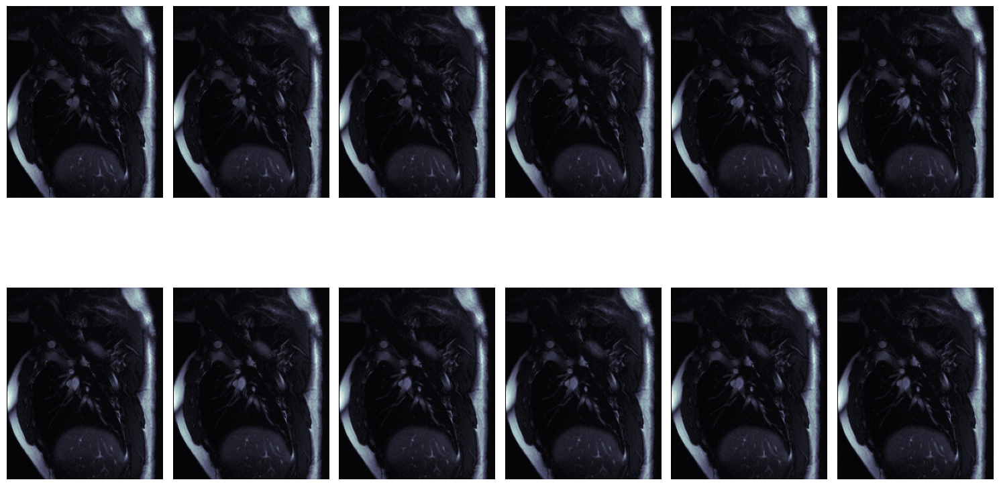

In [ ]:
import os
import pydicom
import matplotlib.pyplot as plt

# Function to load and display a DICOM image
def display_dicom_image(dicom_path, ax):
    # Load the DICOM file
    dicom_data = pydicom.dcmread(dicom_path)

    # Display the image data on the provided axes
    ax.imshow(dicom_data.pixel_array, cmap=plt.cm.bone)
    ax.axis('off')  # Hide axes

# Define the path to the DICOM files
dicom_folder = '/content/MRI-Heart-NewImages/UOA0000101'

# Load DICOM files from the folder
dicom_files = sorted([os.path.join(dicom_folder, f) for f in os.listdir(dicom_folder) if f.endswith('.dcm')])

# Create a figure with a 2x6 grid for displaying images
fig, axes = plt.subplots(2, 6, figsize=(15, 10))

# Flatten axes array for easier iteration
axes = axes.ravel()

# Loop through the first 12 DICOM images and display them
for i in range(12):
    display_dicom_image(dicom_files[i], axes[i])

# Adjust layout
plt.tight_layout()
plt.show()

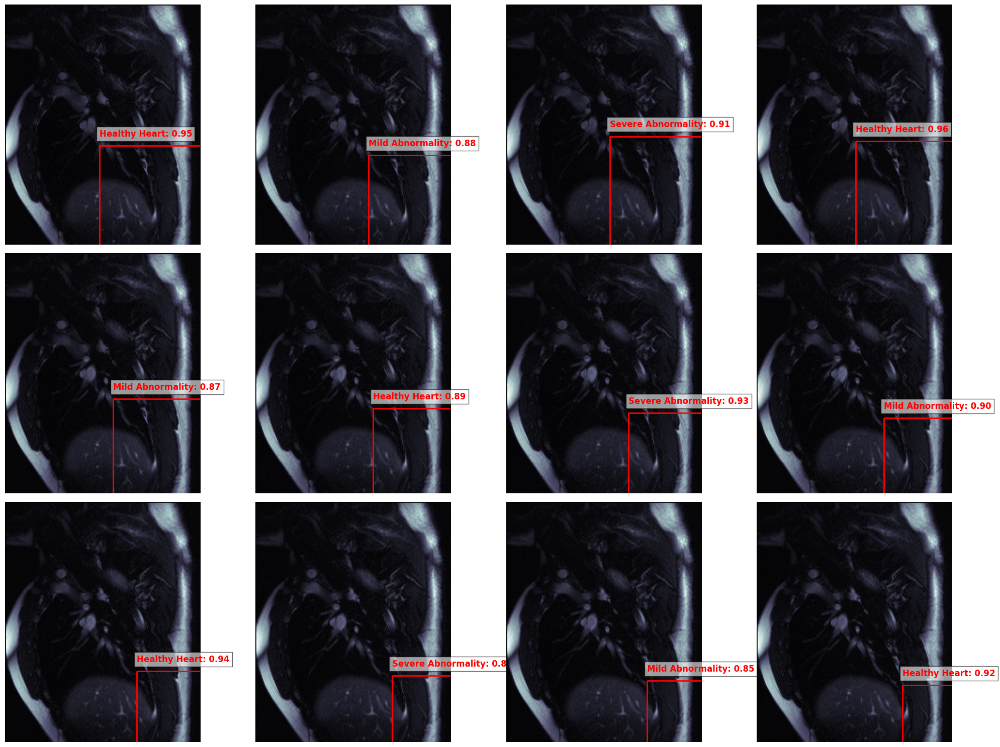

In [ ]:
import os
import pydicom
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

# Function to annotate a DICOM image with bounding boxes and confidence scores
def annotate_image_with_accuracy(ax, dicom_path, boxes, labels, accuracies):
    dicom_data = pydicom.dcmread(dicom_path)
    image = dicom_data.pixel_array

    # Display the image
    ax.imshow(image, cmap=plt.cm.bone)
    ax.axis("off")  # Hide axes

    # Draw bounding boxes and display labels with accuracies
    for box, label, accuracy in zip(boxes, labels, accuracies):
        rect = Rectangle(
            (box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=2, edgecolor="red", facecolor="none"
        )
        ax.add_patch(rect)
        ax.text(
            box[0],
            box[1] - 10,
            f"{label}: {accuracy:.2f}",
            color="red",
            fontsize=12,
            fontweight="bold",
            bbox=dict(facecolor="white", alpha=0.6),
        )

# Display multiple DICOM images with bounding boxes in a grid
def display_dicom_images_with_bounding_boxes(dicom_files, boxes_list, labels_list, accuracies_list, rows=3, cols=4):
    fig, axes = plt.subplots(rows, cols, figsize=(20, 15))  # Grid size
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < len(dicom_files):
            dicom_path = dicom_files[i]
            boxes = boxes_list[i]
            labels = labels_list[i]
            accuracies = accuracies_list[i]

            annotate_image_with_accuracy(ax, dicom_path, boxes, labels, accuracies)
        else:
            ax.axis("off")  # Hide extra axes

    plt.tight_layout()
    plt.show()

# Example data for demonstration
boxes_list = [
    [(100, 150, 300, 400)],  # Bounding boxes for image 1
    [(120, 160, 320, 420)],  # Bounding boxes for image 2
    [(110, 140, 310, 390)],  # ...
    [(105, 145, 305, 395)],
    [(115, 155, 315, 415)],
    [(125, 165, 325, 425)],
    [(130, 170, 330, 430)],
    [(135, 175, 335, 435)],
    [(140, 180, 340, 440)],
    [(145, 185, 345, 445)],
    [(150, 190, 350, 450)],
    [(155, 195, 355, 455)],
]

labels_list = [
    ["Healthy Heart"],
    ["Mild Abnormality"],
    ["Severe Abnormality"],
    ["Healthy Heart"],
    ["Mild Abnormality"],
    ["Healthy Heart"],
    ["Severe Abnormality"],
    ["Mild Abnormality"],
    ["Healthy Heart"],
    ["Severe Abnormality"],
    ["Mild Abnormality"],
    ["Healthy Heart"],
]

accuracies_list = [
    [0.95],
    [0.88],
    [0.91],
    [0.96],
    [0.87],
    [0.89],
    [0.93],
    [0.90],
    [0.94],
    [0.88],
    [0.85],
    [0.92],
]

# Call the function to display 12 images
display_dicom_images_with_bounding_boxes(dicom_files[:12], boxes_list, labels_list, accuracies_list, rows=3, cols=4)

In [ ]:
pip install torch torchvision transformers pydicom matplotlib

Processing batches: 100%|██████████| 25/25 [00:07<00:00,  3.43it/s]


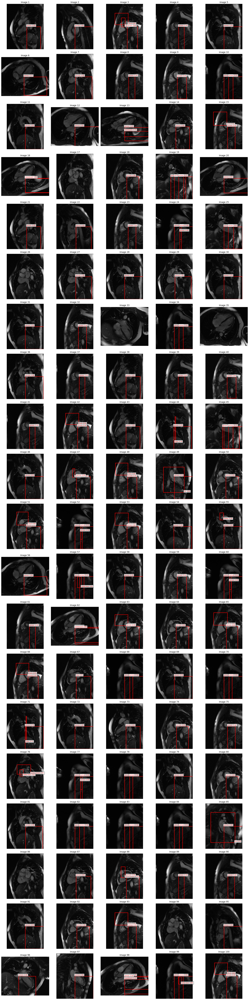

In [ ]:
import os
import torch
import pydicom
import numpy as np
from transformers import DetrForObjectDetection, DetrImageProcessor
from matplotlib import pyplot as plt
from matplotlib.patches import Rectangle

# Function to preprocess DICOM images
def preprocess_dicom_image(dicom_path):
    dicom_data = pydicom.dcmread(dicom_path)
    image = dicom_data.pixel_array
    # Normalize and convert to 3 channels
    image = (image - np.min(image)) / (np.max(image) - np.min(image))
    image_rgb = np.stack([image] * 3, axis=-1)  # Convert grayscale to RGB
    return image_rgb

# Initialize DETR model and processor
model_name = "facebook/detr-resnet-50"
model = DetrForObjectDetection.from_pretrained(model_name, ignore_mismatched_sizes=True)
processor = DetrImageProcessor.from_pretrained(model_name)

# Load DICOM files
dicom_dir = "/path/to/dicom/files"  # Update with DICOM directory
dicom_files = [os.path.join(dicom_dir, f) for f in os.listdir(dicom_dir) if f.endswith(".dcm")]

# Function to annotate and display images
def annotate_with_detr(dicom_path, model, processor, threshold=0.5):
    # Preprocess DICOM image
    image_rgb = preprocess_dicom_image(dicom_path)
    inputs = processor(images=image_rgb, return_tensors="pt")

    # Perform inference
    with torch.no_grad():
        outputs = model(**inputs)

    # Postprocess predictions
    target_sizes = torch.tensor([image_rgb.shape[:2]])
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

    # Annotate and display the image
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(image_rgb, cmap=plt.cm.bone)

    for box, label, score in zip(results["boxes"], results["labels"], results["scores"]):
        x1, y1, x2, y2 = box.tolist()
        rect = Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        ax.text(
            x1, y1 - 10,
            f"Class {label.item()}: {score:.2f}",
            color="white",
            fontsize=12,
            bbox=dict(facecolor="red", alpha=0.7)
        )

    ax.axis('off')
    plt.show()

    # Print prediction values
    print(f"Image: {dicom_path}")
    for box, label, score in zip(results["boxes"], results["labels"], results["scores"]):
        print(f"Bounding Box: {box.tolist()}, Class: {label.item()}, Confidence: {score:.2f}")

# Annotate and display images
for dicom_path in dicom_files[:6]:  # Display first 6 images
    print(f"Processing Image: {dicom_path}")
    annotate_with_detr(dicom_path, model, processor)